In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


In [ ]:
%pip install keras-tuner

In [ ]:
import os
import numpy as np
import shutil
import cv2
import numpy as np
import tensorflow as tf
import keras_tuner as kt
import matplotlib.pyplot as plt
from google.colab import files
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.applications import VGG16
from sklearn.model_selection import GridSearchCV
from tensorflow.keras.optimizers import Adam, RMSprop, SGD

In [ ]:
!unzip -n /content/dataset_zip/Run.zip -d /content/dataset_zip/Run/

Archive:  /content/dataset_zip/Run.zip
  inflating: /content/dataset_zip/Run/Image_10017.jpg  
  inflating: /content/dataset_zip/Run/Image_10032.jpg  
  inflating: /content/dataset_zip/Run/Image_10038.jpg  
  inflating: /content/dataset_zip/Run/Image_10050.jpg  
  inflating: /content/dataset_zip/Run/Image_10054.jpg  
  inflating: /content/dataset_zip/Run/Image_10058.jpg  
  inflating: /content/dataset_zip/Run/Image_10060.jpg  
  inflating: /content/dataset_zip/Run/Image_10100.jpg  
  inflating: /content/dataset_zip/Run/Image_10108.jpg  
  inflating: /content/dataset_zip/Run/Image_10116.jpg  
  inflating: /content/dataset_zip/Run/Image_10117.jpg  
  inflating: /content/dataset_zip/Run/Image_1012.jpg  
  inflating: /content/dataset_zip/Run/Image_10126.jpg  
  inflating: /content/dataset_zip/Run/Image_10183.jpg  
  inflating: /content/dataset_zip/Run/Image_10195.jpg  
  inflating: /content/dataset_zip/Run/Image_10251.jpg  
  inflating: /content/dataset_zip/Run/Image_10269.jpg  
  inflatin

In [ ]:
!unzip -n /content/dataset_zip/Walk.zip -d /content/dataset_zip/Walk/

Archive:  /content/dataset_zip/Walk.zip
  inflating: /content/dataset_zip/Walk/humanwalkV1_jpg.rf.44320adf51a34f6f6fe3f94b8285c9b0.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV1_jpg.rf.a0fee6245c425ebbfb3ee4435baf5eaf.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV10_jpg.rf.299dea720f0808676e2f63f6134c29bd.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV10_jpg.rf.d5adee0f0780b89d924b760f81335fd3.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV100_jpg.rf.0341ee76449d74b7ddbda2e73ce1bc2b.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV100_jpg.rf.c125896fd3b3bc7087ad75f07e635937.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV101_jpg.rf.22723134672112473470fc4f3cd87bca.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV101_jpg.rf.f9c9638a77d107c66f7a98f5562ccc5d.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV102_jpg.rf.0486df5757dd966434eb422a01f61a01.jpg  
  inflating: /content/dataset_zip/Walk/humanwalkV102_jpg.rf.d87ae4340e7522c

In [ ]:
data_dir = '/content/dataset'
train_dir = '/content/dataset/train'
test_dir = '/content/dataset/test'
categories = ['Run', 'Walk']

os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

for category in categories:
    os.makedirs(os.path.join(train_dir, category), exist_ok=True)
    os.makedirs(os.path.join(test_dir, category), exist_ok=True)

for category in categories:
    category_path = os.path.join(data_dir, category)
    images = os.listdir(category_path)
    train_images, test_images = train_test_split(images, test_size=0.2, random_state=1)

    for img in train_images:
        shutil.copy(os.path.join(category_path, img), os.path.join(train_dir, category, img))

    for img in test_images:
        shutil.copy(os.path.join(category_path, img), os.path.join(test_dir, category, img))

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary',
    subset='validation'
)

test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary',
    shuffle=False
)

Found 2542 images belonging to 2 classes.
Found 634 images belonging to 2 classes.
Found 795 images belonging to 2 classes.


In [ ]:
def create_model(hp):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(150, 150, 3))
    base_model.trainable = False

    model = Sequential()
    model.add(base_model)

    for i in range(hp.Int('conv_blocks', 1, 3, default=2)):
        model.add(Conv2D(
            filters=hp.Int(f'conv_{i}_filters', min_value=32, max_value=256, step=32),
            kernel_size=hp.Choice(f'conv_{i}_kernel', values=[3, 5]),
            activation='relu',
            padding='same'
        ))
        model.add(BatchNormalization())
        model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Flatten())
    model.add(Dense(
        units=hp.Int('dense_units', min_value=128, max_value=512, step=128),
        activation='relu'
    ))
    model.add(Dropout(hp.Float('dropout', min_value=0.2, max_value=0.5, step=0.1)))
    model.add(Dense(1, activation='sigmoid'))

    optimizer = hp.Choice('optimizer', values=['adam', 'rmsprop', 'sgd'])
    optimizers = {
        'adam': Adam(),
        'rmsprop': RMSprop(),
        'sgd': SGD()
    }

    model.compile(
        optimizer=optimizers[optimizer],
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    return model

In [ ]:
tuner = kt.RandomSearch(
    create_model,
    objective='val_accuracy',
    max_trials=10,
    executions_per_trial=1,
    directory='result',
    project_name='actionclassifier'
)

tuner.search(train_generator, epochs=10, validation_data=validation_generator)

if len(tuner.oracle.get_best_trials()) == 0:
    raise ValueError("No trials were completed")

best_hps = tuner.get_best_hyperparameters()[0]

print(f"""Conv blocks: {best_hps.get('conv_blocks')},
Filters: {[best_hps.get(f'conv_{i}_filters') for i in range(best_hps.get('conv_blocks'))]},
Kernel sizes: {[best_hps.get(f'conv_{i}_kernel') for i in range(best_hps.get('conv_blocks'))]},
Dense units: {best_hps.get('dense_units')},
Dropout rate: {best_hps.get('dropout')},
Optimizer: {best_hps.get('optimizer')}.""")

best_model = tuner.hypermodel.build(best_hps)

history = best_model.fit(train_generator, epochs=10, validation_data=validation_generator)

best_model.save('model.h5')

files.download('model.h5')

test_loss, test_accuracy = best_model.evaluate(test_generator)
print(f"Test accuracy: {test_accuracy:.4f}")
print(f"Test loss: {test_loss:.4f}")

Trial 10 Complete [00h 00m 02s]

Best val_accuracy So Far: 0.8359621167182922
Total elapsed time: 00h 32m 53s
Conv blocks: 1,
Filters: [96],
Kernel sizes: [3],
Dense units: 128,
Dropout rate: 0.2,
Optimizer: rmsprop.
Epoch 1/10
80/80 ━━━━━━━━━━━━━━━━━━━━ 35s 391ms/step - accuracy: 0.7583 - loss: 0.6690 - val_accuracy: 0.7776 - val_loss: 0.4538
Epoch 2/10
80/80 ━━━━━━━━━━━━━━━━━━━━ 25s 306ms/step - accuracy: 0.8637 - loss: 0.3158 - val_accuracy: 0.7303 - val_loss: 0.5183
Epoch 3/10
80/80 ━━━━━━━━━━━━━━━━━━━━ 25s 315ms/step - accuracy: 0.8899 - loss: 0.2640 - val_accuracy: 0.7902 - val_loss: 0.4573
Epoch 4/10
80/80 ━━━━━━━━━━━━━━━━━━━━ 24s 293ms/step - accuracy: 0.8838 - loss: 0.2502 - val_accuracy: 0.8423 - val_loss: 0.4071
Epoch 5/10
80/80 ━━━━━━━━━━━━━━━━━━━━ 24s 303ms/step - accuracy: 0.9243 - loss: 0.1802 - val_accuracy: 0.7760 - val_loss: 0.6752
Epoch 6/10
80/80 ━━━━━━━━━━━━━━━━━━━━ 24s 302ms/step - accuracy: 0.9303 - loss: 0.1876 - val_accuracy: 0.7808 - val_loss: 0.5265
Epoch 7/1

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

25/25 ━━━━━━━━━━━━━━━━━━━━ 8s 333ms/step - accuracy: 0.8475 - loss: 0.4295
Test accuracy: 0.8604
Test loss: 0.4691


In [ ]:
train_generator.class_indices

{'Run': 0, 'Walk': 1}

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


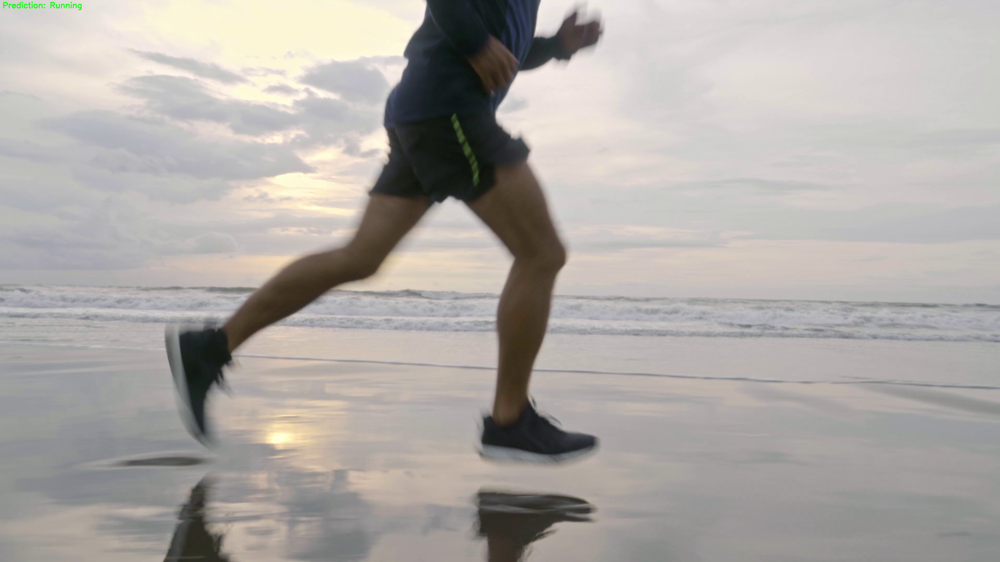

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


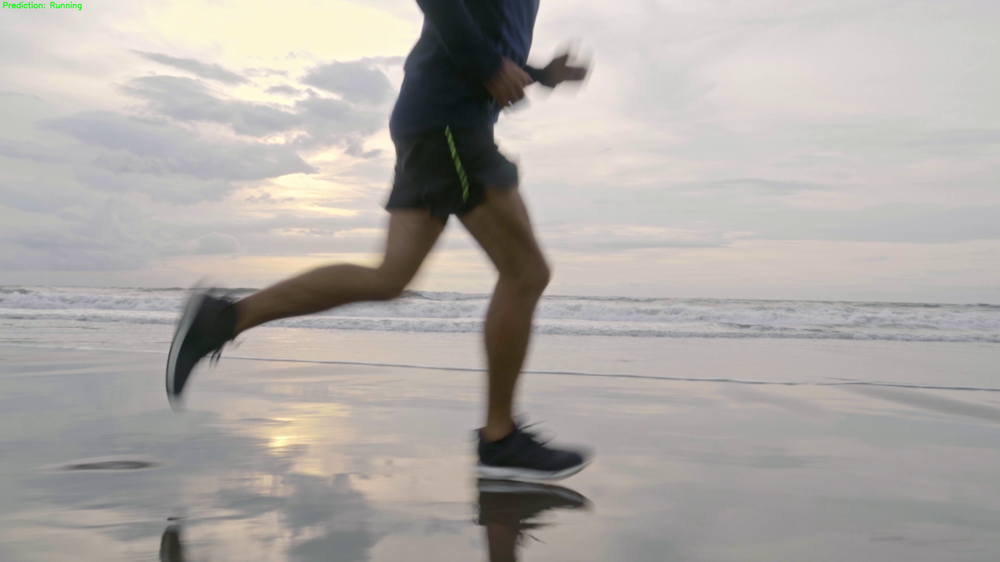

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


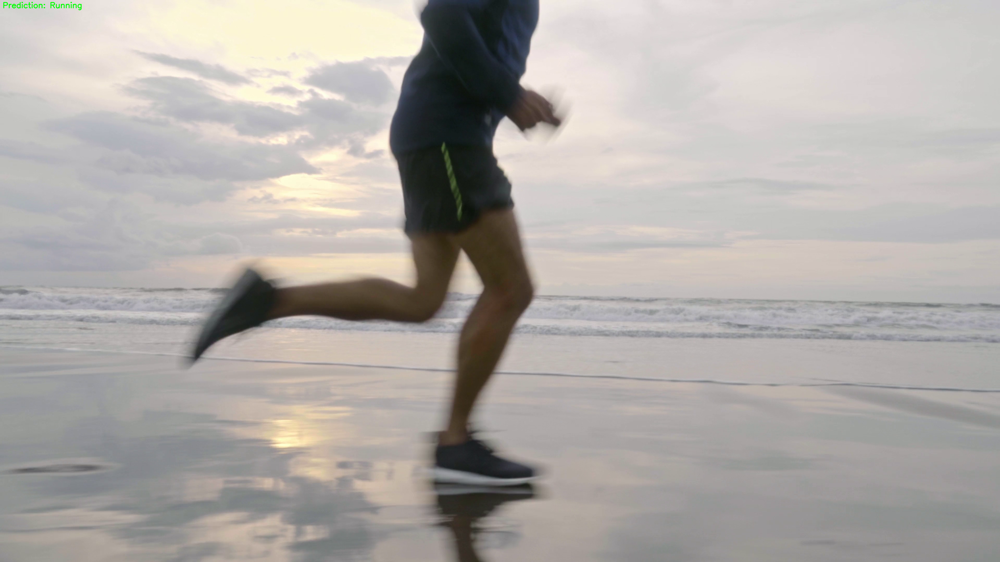

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


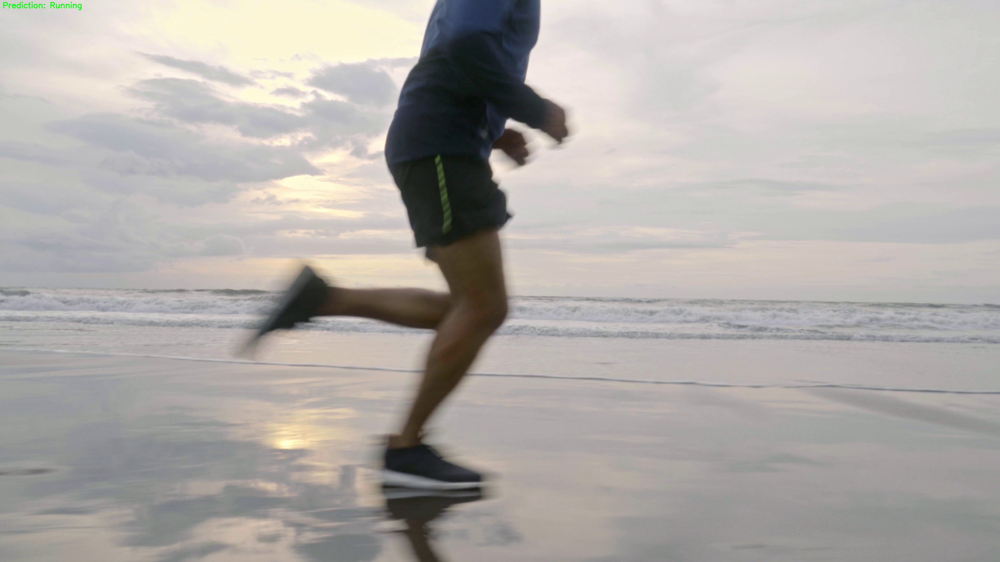

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


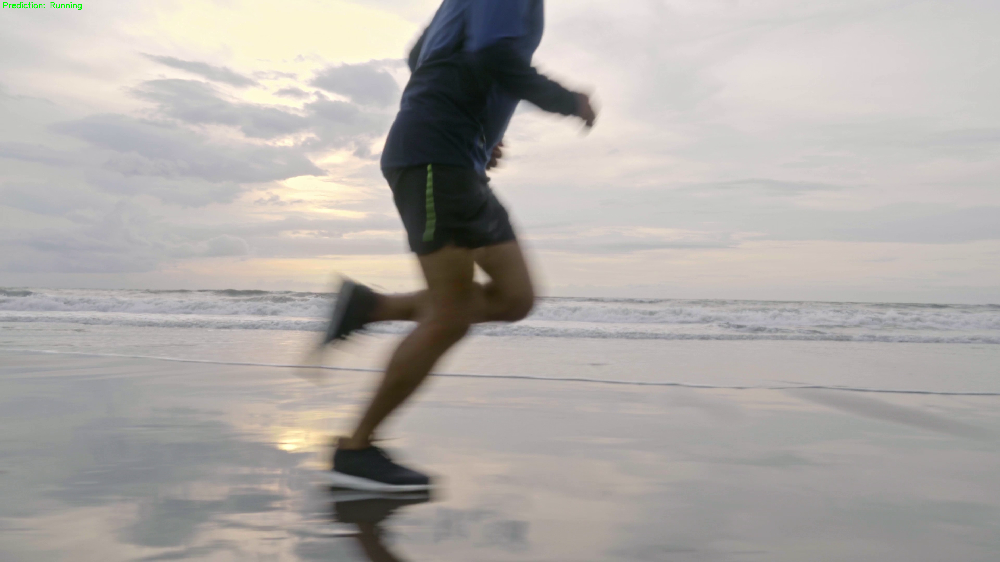

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


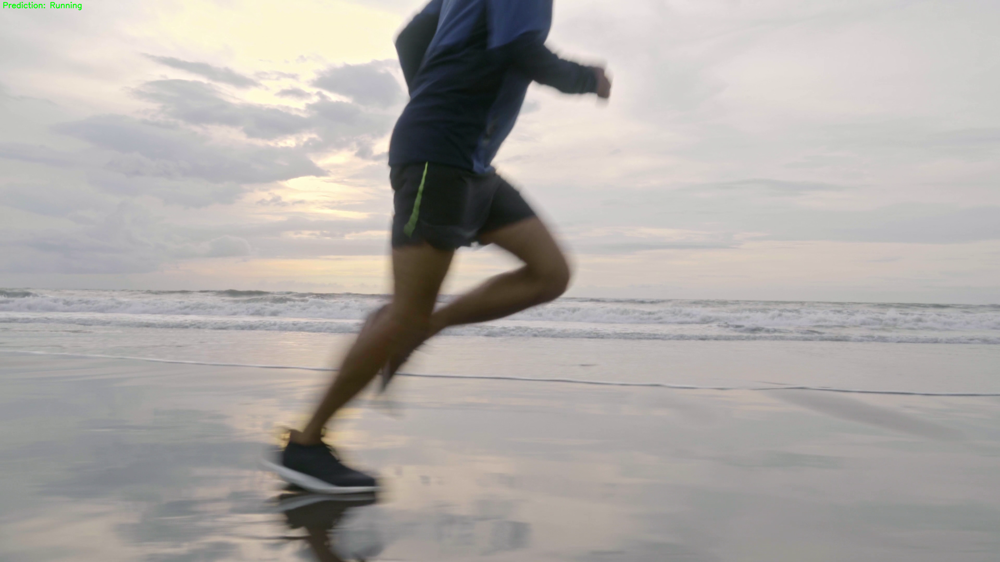

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


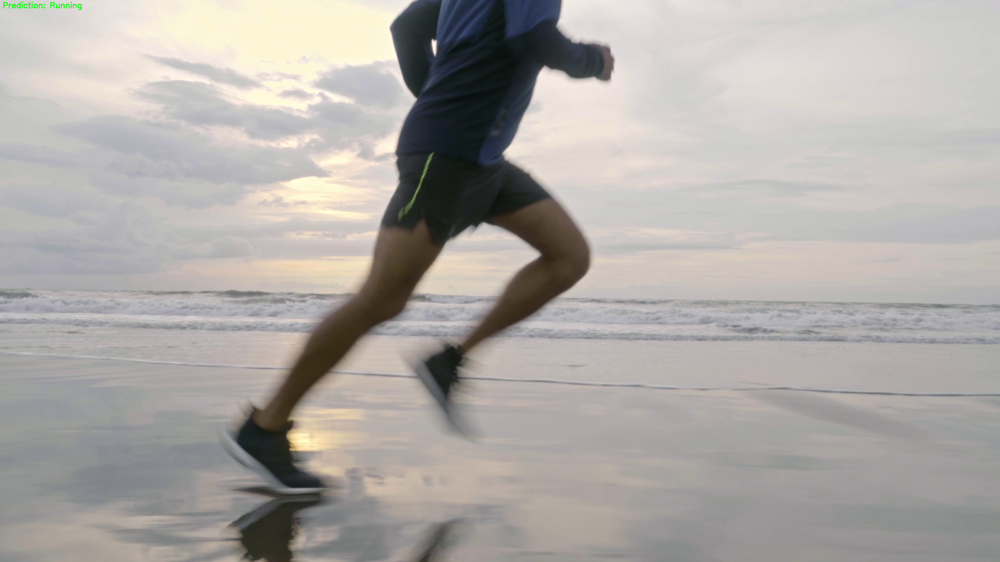

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Buffered data was truncated after reaching the output size limit.

In [15]:
def process_image(image_path):
    img = load_img(image_path, target_size=(150, 150))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0

    prediction = best_model.predict(img_array)
    if prediction[0] > 0.5:
        print("Walking.")
    else:
        print("Running.")

def process_video(video_path):
    cap = cv2.VideoCapture(video_path)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        resized_frame = cv2.resize(frame, (150, 150))
        img_array = img_to_array(resized_frame)
        img_array = np.expand_dims(img_array, axis=0)
        img_array /= 255.0

        prediction = best_model.predict(img_array)
        if prediction[0] > 0.5:
            class_label = 'Walking'
        else:
            class_label = 'Running'

        cv2.putText(frame, f'Prediction: {class_label}', (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

        # Use cv2_imshow instead of cv2.imshow
        cv2_imshow(frame)
        # Optionally pause a little (e.g., 30ms) between frames
        import time
        time.sleep(0.03)

        # Optionally, remove the waitKey loop since interactive closing may not work in Colab

    cap.release()
    cv2.destroyAllWindows()

    source = '/content/run.mp4'
file_extension = os.path.splitext(source)[1].lower()

if file_extension in ['.jpg', '.jpeg', '.png', '.bmp']:
    process_image(source)
elif file_extension in ['.mp4', '.avi', '.mov', '.mkv']:
    process_video(source)
else:
    print("Unsupported file type.")